In [1]:
import json
import pandas as pd
import numpy as np
import sys
import csv
import plotly.express as px
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns


csv.field_size_limit(sys.maxsize)


131072

In [2]:
chunks = pd.read_csv("/content/drive/MyDrive/yelp_data_ready1.csv", engine='python', chunksize = 500000)
counter = 1
for c in chunks:
  if counter == 1: 
    print(counter)
    df = c.copy()
    counter += 1
  else: 
    print(counter)
    df = pd.concat([df,c])
    counter += 1
  #Chunk is like a list of dataframes


1
2
3
4
5
6
7
8
9
10


In [61]:
df.head()

,Unnamed: 0,review_id,user_id,business_id,stars_x,date,review_year,review_month,review_date,city,state,postal_code,latitude,longitude,stars_y,review_count,is_open,categories,is_restaurant,is_vegan_restaurant,is_vegetarian_restaurant,is_omnivore_restaurant,biz_veg_code,user_vegan,user_vegetarian,user_omnivore,user_veg_code
0,0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,2018-07-07 22:09:11,2018,7,7,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.000000,0.000000,1.000000,Omnivore
1,1,VJxlBnJmCDIy8DFG0kjSow,Iaee7y6zdSB3B-kRCo4z1w,XQfwVwDr-v0ZS3_CbbE5Xw,2,2017-05-13 17:06:55,2017,5,13,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.000000,0.000000,1.000000,Omnivore
2,2,S6pQZQocMB1WHMjTRbt77A,ejFxLGqQcWNLdNByJlIhnQ,XQfwVwDr-v0ZS3_CbbE5Xw,4,2017-08-08 00:58:18,2017,8,8,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.020619,0.061856,0.938144,Omnivore
3,3,WqgTKVqWVHDHjnjEsBvUgg,f7xa0p_1V9lx53iIGN5Sug,XQfwVwDr-v0ZS3_CbbE5Xw,3,2017-11-19 02:20:23,2017,11,19,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.018692,0.037383,0.962617,Omnivore
4,4,M0wzFFb7pefOPcxeRVbLag,dCooFVCk8M1nVaQqcfTL3Q,XQfwVwDr-v0ZS3_CbbE5Xw,2,2017-09-09 17:49:47,2017,9,9,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.000000,0.000000,1.000000,Omnivore


In [14]:
df.user_veg_code.value_counts()

Omnivore      4155842
Vegan          176221
Vegetarian     170782
Name: user_veg_code, dtype: int64

In [15]:
df.biz_veg_code.value_counts()

Omnivore      4277218
Vegetarian     174119
Vegan           51508
Name: biz_veg_code, dtype: int64

In [3]:
#Removing entries before 2012 and after 2021 due to small sample sizes.
df = df[df['review_year'] > 2011]
df = df[df['review_year'] < 2022]


In [13]:
df.head()

,Unnamed: 0,review_id,user_id,business_id,stars_x,date,review_year,review_month,review_date,city,...,categories,is_restaurant,is_vegan_restaurant,is_vegetarian_restaurant,is_omnivore_restaurant,biz_veg_code,user_vegan,user_vegetarian,user_omnivore,user_veg_code
0,0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,2018-07-07 22:09:11,2018,7,7,North Wales,...,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.000000,0.000000,1.000000,Omnivore
1,1,VJxlBnJmCDIy8DFG0kjSow,Iaee7y6zdSB3B-kRCo4z1w,XQfwVwDr-v0ZS3_CbbE5Xw,2,2017-05-13 17:06:55,2017,5,13,North Wales,...,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.000000,0.000000,1.000000,Omnivore
2,2,S6pQZQocMB1WHMjTRbt77A,ejFxLGqQcWNLdNByJlIhnQ,XQfwVwDr-v0ZS3_CbbE5Xw,4,2017-08-08 00:58:18,2017,8,8,North Wales,...,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.020619,0.061856,0.938144,Omnivore
3,3,WqgTKVqWVHDHjnjEsBvUgg,f7xa0p_1V9lx53iIGN5Sug,XQfwVwDr-v0ZS3_CbbE5Xw,3,2017-11-19 02:20:23,2017,11,19,North Wales,...,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.018692,0.037383,0.962617,Omnivore
4,4,M0wzFFb7pefOPcxeRVbLag,dCooFVCk8M1nVaQqcfTL3Q,XQfwVwDr-v0ZS3_CbbE5Xw,2,2017-09-09 17:49:47,2017,9,9,North Wales,...,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.000000,0.000000,1.000000,Omnivore


In [ ]:
#Method for reading in random rows for sentiment analysis
#import random

#filename = "/content/drive/MyDrive/yelp_review.csv"
#n = sum(1 for line in open(filename)) - 1 #number of records in file (excludes header)
#s = 500000 #desired sample size
#skip = sorted(random.sample(range(1,n+1),n-s)) #the 0-indexed header will not be included in the skip list
#df = pd.read_csv(filename, skiprows=skip) 

In [ ]:
#from google.colab import files
#uploaded = files.upload()


In [ ]:
#import io
#df2 = pd.read_csv(io.BytesIO(uploaded['yelp_business_attributes.csv']))
# Dataset is now stored in a Pandas Dataframe

In [ ]:
#Ignore for analyses - too many missing values
#File #1
#biz_attr_df = pd.read_csv("/content/drive/MyDrive/yelp_business_attributes.csv", sep=',', engine='python')

#biz_attr_df.head(30)
#reviews_df = pd.read_csv("archive/yelp_review.csv", sep=',', engine='python')

In [53]:
#File #1
biz_attr_df = pd.read_json("/content/drive/MyDrive/yelp_academic_dataset_business.json", lines=True)

pd.set_option('display.max_columns', None)

biz_attr_df = biz_attr_df.drop(['name','address', 'attributes','hours'],axis=1)
biz_attr_df.head()


,business_id,city,state,postal_code,latitude,longitude,stars,review_count,is_open,categories
0,Pns2l4eNsfO8kk83dixA6A,Santa Barbara,CA,93101,34.426679,-119.711197,5.0,7,0,"Doctors, Traditional Chinese Medicine, Naturop..."
1,mpf3x-BjTdTEA3yCZrAYPw,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,"Shipping Centers, Local Services, Notaries, Ma..."
2,tUFrWirKiKi_TAnsVWINQQ,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"Department Stores, Shopping, Fashion, Home & G..."
3,MTSW4McQd7CbVtyjqoe9mw,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"Restaurants, Food, Bubble Tea, Coffee & Tea, B..."
4,mWMc6_wTdE0EUBKIGXDVfA,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"Brewpubs, Breweries, Food"


In [ ]:
#Coding biz as restaurant or not
is_restaurant = []
for item in biz_attr_df['categories']:
  if item == None:
    is_restaurant.append(0)
  elif item.find('Restaurants') != -1:
    is_restaurant.append(1)
  else: 
    is_restaurant.append(0)

biz_attr_df['is_restaurant'] = is_restaurant
#Removing non-restaurants
biz_attr_df = biz_attr_df.loc[biz_attr_df['is_restaurant'] == 1,:]
biz_attr_df.shape


(52268, 11)

In [ ]:
#Coding biz as vegan or vegetarian restaurant or not
#Coding as vegan first to preempt vegetarian restaurants overlapping them
is_vegan_restaurant = []
for item in biz_attr_df['categories']:
  if item == None:
    is_vegan_restaurant.append(0)
  elif item.find('Vegan') != -1:
    is_vegan_restaurant.append(1)
  else: 
    is_vegan_restaurant.append(0)

biz_attr_df['is_vegan_restaurant'] = is_vegan_restaurant

is_vegetarian_restaurant = []
for item in biz_attr_df['categories']:
  if item == None:
    is_vegetarian_restaurant.append(0)
  elif item.find('Vegan') != -1:
    is_vegetarian_restaurant.append(0)
  elif item.find('Vegetarian') != -1:
    is_vegetarian_restaurant.append(1)
  else: 
    is_vegetarian_restaurant.append(0)

biz_attr_df['is_vegetarian_restaurant'] = is_vegetarian_restaurant

def is_omnivore(is_vegetarian,is_vegan):
   if is_vegetarian or is_vegan:
     return 0
   return 1

biz_attr_df['is_omnivore_restaurant'] = biz_attr_df.apply(lambda x: is_omnivore(x['is_vegetarian_restaurant'],x['is_vegan_restaurant']), axis = 1)

def veg_code(is_vegetarian,is_vegan):
  if is_vegetarian:
    return 'Vegetarian'
  if is_vegan:
    return 'Vegan'
  return 'Omnivore'

biz_attr_df['biz_veg_code'] = biz_attr_df.apply(lambda x: veg_code(x['is_vegetarian_restaurant'],x['is_vegan_restaurant']), axis = 1)

In [ ]:
is_vegan_restaurant.count(1)

In [ ]:
is_vegetarian_restaurant.count(1)

1158

In [58]:
#Counting number of restaurants coded as both vegetarian and vegan

counter = 0
for item in biz_attr_df['categories']:
  if item == None:
    counter += 0
  elif((item.find('Vegan') != -1) and (item.find('Vegetarian') != -1)):
    counter += 1
  else: 
        counter += 0

print(counter)

385


In [64]:
df[(df['is_vegetarian_restaurant'] == 1) & (df['is_vegan_restaurant'] ==1)]['is_vegetarian_restaurant']=0
df[(df['is_vegetarian_restaurant'] == 1) & (df['is_vegan_restaurant'] ==1)]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Unnamed: 0,review_id,user_id,business_id,stars_x,date,review_year,review_month,review_date,city,state,postal_code,latitude,longitude,stars_y,review_count,is_open,categories,is_restaurant,is_vegan_restaurant,is_vegetarian_restaurant,is_omnivore_restaurant,biz_veg_code,user_vegan,user_vegetarian,user_omnivore,user_veg_code
38473,38473,3dVcGYz6GokuEytLrfG8bA,FEI0XkOrUHufSW_rfOTPAA,Dv6RfXLYe1atjgz3Xf4GGw,4,2012-12-04 23:58:36,2012,12,4,Philadelphia,PA,19103,39.950774,-75.170397,4.0,1082,1,"Burgers, Vegetarian, Restaurants, Vegan",1,1,1,0,Vegetarian,0.117647,0.058824,0.882353,Omnivore
38474,38474,nCdhMSQA0apDuB_oho5ang,2dyfZNhtyuHdestczTgWjQ,Dv6RfXLYe1atjgz3Xf4GGw,4,2012-08-15 19:17:49,2012,8,15,Philadelphia,PA,19103,39.950774,-75.170397,4.0,1082,1,"Burgers, Vegetarian, Restaurants, Vegan",1,1,1,0,Vegetarian,0.020833,0.062500,0.937500,Omnivore
38475,38475,wUHUieO_gckt0HcrrI63PQ,5ucOKo929N6dPfNjLuFoEA,Dv6RfXLYe1atjgz3Xf4GGw,5,2013-02-22 00:48:28,2013,2,22,Philadelphia,PA,19103,39.950774,-75.170397,4.0,1082,1,"Burgers, Vegetarian, Restaurants, Vegan",1,1,1,0,Vegetarian,0.100000,0.100000,0.900000,Omnivore
38476,38476,qMVwOQNDqYzwodlFJ81GNw,pqlLJVba9KAtahkjvNINYg,Dv6RfXLYe1atjgz3Xf4GGw,4,2018-07-26 12:37:10,2018,7,26,Philadelphia,PA,19103,39.950774,-75.170397,4.0,1082,1,"Burgers, Vegetarian, Restaurants, Vegan",1,1,1,0,Vegetarian,0.080000,0.120000,0.860000,Omnivore
38477,38477,qeW_tAQwF_7Ua40LtGMnow,gCRBwUVGLxoxm85deceFLA,Dv6RfXLYe1atjgz3Xf4GGw,4,2014-08-24 21:21:28,2014,8,24,Philadelphia,PA,19103,39.950774,-75.170397,4.0,1082,1,"Burgers, Vegetarian, Restaurants, Vegan",1,1,1,0,Vegetarian,0.363636,0.090909,0.636364,Vegan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4723031,4723031,mVhGlmUGWraYdkyW879W7g,o3TSIMPBA3dfNzW4OgWpoA,nPThV_rUBGyscA5setQtfg,4,2021-09-03 19:27:03,2021,9,3,Media,PA,19063,39.917888,-75.390159,4.5,12,1,"Juice Bars & Smoothies, Vegetarian, Restaurant...",1,1,1,0,Vegetarian,0.375000,0.375000,0.625000,Vegan
4723032,4723032,YWkUH7R3F8ILE3Aqk8CPig,m1VGxZRRsB3aOGq5nYCeiQ,nPThV_rUBGyscA5setQtfg,5,2021-07-29 18:31:59,2021,7,29,Media,PA,19063,39.917888,-75.390159,4.5,12,1,"Juice Bars & Smoothies, Vegetarian, Restaurant...",1,1,1,0,Vegetarian,1.000000,1.000000,0.000000,Vegan
4723033,4723033,oVUS5cAQKzGy8R729n7eHQ,xoD3dA8pov6lijtDnTdbQg,nPThV_rUBGyscA5setQtfg,5,2021-06-20 00:10:36,2021,6,20,Media,PA,19063,39.917888,-75.390159,4.5,12,1,"Juice Bars & Smoothies, Vegetarian, Restaurant...",1,1,1,0,Vegetarian,0.250000,0.250000,0.750000,Vegan
4723034,4723034,xHP9kT7qTBZGS_OVlefudQ,ZgObuM95bKaH7MGMKw4JPw,nPThV_rUBGyscA5setQtfg,5,2021-07-31 21:18:54,2021,7,31,Media,PA,19063,39.917888,-75.390159,4.5,12,1,"Juice Bars & Smoothies, Vegetarian, Restaurant...",1,1,1,0,Vegetarian,1.000000,1.000000,0.000000,Vegan


In [60]:
counter = 0
for item in biz_attr_df['categories']:
  if item == None:
    counter += 0
  elif(item.find('Vegetarian') != -1):
    counter += 1
  else: 
        counter += 0

print(counter)

1158


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f6504341f50>]],
      dtype=object)

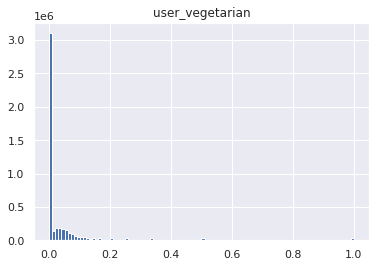

In [21]:
df.hist(column = 'user_vegetarian', bins =100 )

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f6501b506d0>]],
      dtype=object)

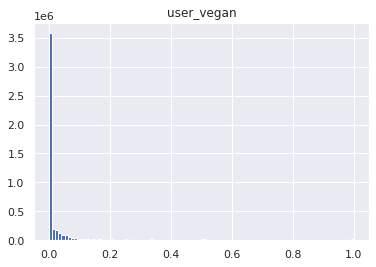

In [22]:
df.hist(column = 'user_vegan', bins =100 )

In [ ]:
#Recode the veg_quant function to code 

In [3]:
df.value_counts(user_veg_code)

NameError: ignored

/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X = np.atleast_1d(X.T if isinstance(X, np.ndarray) else np.asarray(X))


Text(0, 0.5, 'Star Rating by Food Type')

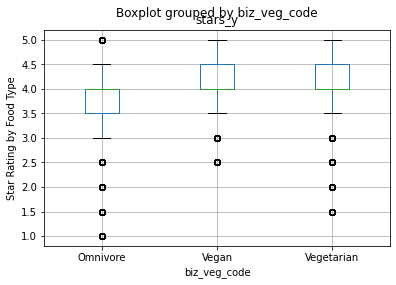

In [4]:
df.boxplot(by = 'biz_veg_code', column = 'stars_y')
plt.ylabel('Star Rating by Food Type')


/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X = np.atleast_1d(X.T if isinstance(X, np.ndarray) else np.asarray(X))


Text(0, 0.5, 'Number of Reviews by Food Type')

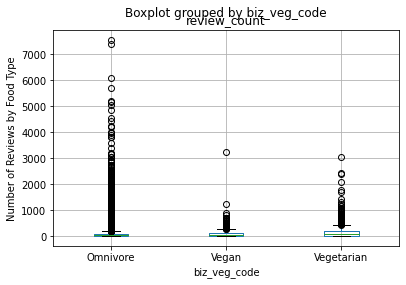

In [ ]:
biz_attr_df.boxplot(by = 'biz_veg_code', column = 'review_count')
plt.ylabel('Number of Reviews by Food Type')

/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X = np.atleast_1d(X.T if isinstance(X, np.ndarray) else np.asarray(X))


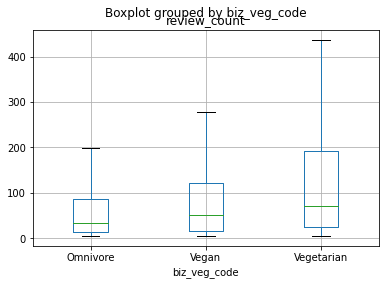

In [ ]:
biz_attr_df.boxplot(by = 'biz_veg_code', column = 'review_count', showfliers=False)


/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X = np.atleast_1d(X.T if isinstance(X, np.ndarray) else np.asarray(X))


Text(0, 0.5, 'Number of Reviews by Food Type')

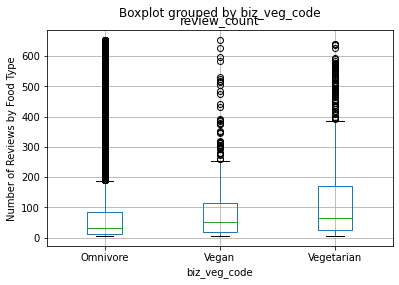

In [ ]:
from scipy import stats
#removing outliers beyond 3 sd.
df = df[(np.abs(stats.zscore(df['review_count'])) < 3)]
df.boxplot(by = 'biz_veg_code', column = 'review_count')
plt.ylabel('Number of Reviews by Food Type')

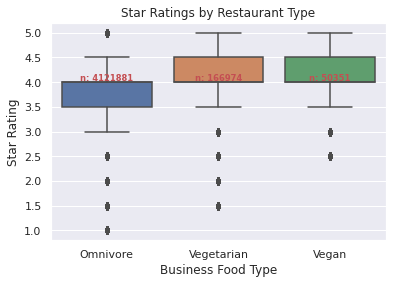

In [37]:
# libraries & dataset
import seaborn as sns
sns.set(style="darkgrid")
 
ax = sns.boxplot(x="biz_veg_code", y="stars_y", data= df)
ax.set(xlabel='Business Food Type', ylabel = 'Star Rating', title = 'Star Ratings by Restaurant Type')
 
# Calculate number of obs per group & median to position labels
medians = df.groupby(['biz_veg_code'])['stars_y'].median().values
nobs = df['biz_veg_code'].value_counts().values
nobs = [str(x) for x in nobs.tolist()]
nobs = ["n: " + i for i in nobs]
 
# Add it to the plot
pos = range(len(nobs))
for tick,label in zip(pos,ax.get_xticklabels()):
    ax.text(pos[tick],
            medians[tick] + 0.03,
            nobs[tick],
            horizontalalignment='center',
            size='x-small',
            color='r',
            weight='semibold'
            )
 
plt.show()

[Text(0, 0.5, 'Star Rating'),
 Text(0.5, 0, 'Business Food Type'),
 Text(0.5, 1.0, 'Star Ratings by Restaurant Food Type')]

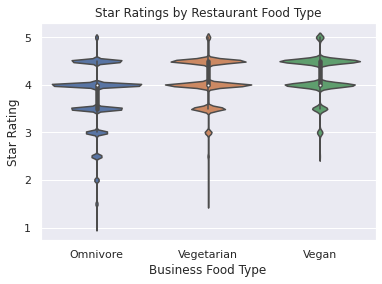

In [7]:
ax = sns.violinplot(x="biz_veg_code", y="stars_y", data= df)
ax.set(xlabel='Business Food Type', ylabel = 'Star Rating', title = 'Star Ratings by Restaurant Type')

[Text(0, 0.5, 'Review Count'),
 Text(0.5, 0, 'Business Food Type'),
 Text(0.5, 1.0, 'Review Count by Restaurant Type')]

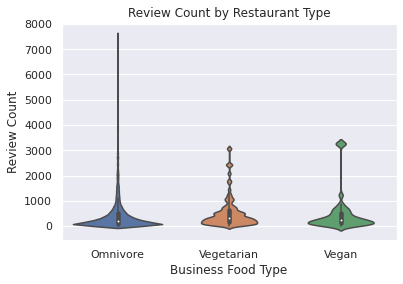

In [38]:
ax = sns.violinplot(x="biz_veg_code", y="review_count", data= df)
ax.set(xlabel='Business Food Type', ylabel = 'Review Count', title = 'Review Count by Restaurant Type')

In [21]:
omnivore_rows=df.query('biz_veg_code == "Omnivore"')
omni_entries=omnivore_rows.stars_y
vegan_rows=df.query('biz_veg_code == "Vegan"')    
vegan_entries=vegan_rows.stars_y
vegetarian_rows=df.query('biz_veg_code == "Vegetarian"')
vegetarian_entries=vegetarian_rows.stars_y

In [19]:
stats.kruskal(omni_entries, vegan_entries, vegetarian_entries)

KruskalResult(statistic=61496.99112735839, pvalue=0.0)

In [22]:
#This shows all three medians are statistically different from each other.
!pip install scikit-posthocs

import scikit_posthocs as sp
dunn_test = [omni_entries, vegan_entries, vegetarian_entries]
sp.posthoc_dunn(dunn_test, p_adjust = 'bonferroni')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


,1,2,3
1,1.0,0.0,0.0
2,0.0,1.0,0.0
3,0.0,0.0,1.0


In [ ]:
#Attempting to load the entire reviews data set in at once - doesn't work
#reviews_df = pd.read_json("/content/drive/MyDrive/yelp_academic_dataset_review.json", lines = True)


In [ ]:
#Splitting up the 5261668 rows in yelp_review.csv into three chunks for easier processing
chunks = pd.read_json("/content/drive/MyDrive/yelp_academic_dataset_review.json", chunksize = 500000, lines = True)
counter = 1
for c in chunks:
  if counter == 1: 
    print(counter)
    df = c.copy()
    counter += 1
  else: 
    print(counter)
    df = pd.concat([df,c])
    counter += 1

#reviews_df1 = pd.read_csv("/content/drive/MyDrive/yelp_review.csv", sep=',', engine='python', nrows = 2000000)
# Dataset is now stored in a Pandas Dataframe

1
2
3
4
5
6
7
8
9
10
11
12
13
14


In [ ]:
#Number of rows in review data frame is 6990280
df.shape

(6990280, 9)

In [ ]:
df = df.drop(['useful', 'funny', 'cool'], axis=1)

In [ ]:
#Optional to conserve memory: drop text column
df = df.drop(['text'], axis=1)

In [ ]:
#Create columns with year, month, and day for graphing
df['review_year'] = df['date'].dt.year
df['review_month'] = df['date'].dt.month
df['review_date'] = df['date'].dt.day

In [ ]:
df.head()

,review_id,user_id,business_id,stars,date,review_year,review_month,review_date
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,2018-07-07 22:09:11,2018,7,7
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5,2012-01-03 15:28:18,2012,1,3
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3,2014-02-05 20:30:30,2014,2,5
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5,2015-01-04 00:01:03,2015,1,4
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4,2017-01-14 20:54:15,2017,1,14


In [ ]:
#reviews_df1.shape

In [ ]:
#rows_to_skip1 = range(1,2000001)

#reviews_df2 = pd.read_json("/content/drive/MyDrive/yelp_academic_dataset_review.json", skiprows = rows_to_skip1, nrows = 2000000, lines = True)

#reviews_df2 = pd.read_csv("/content/drive/MyDrive/yelp_review.csv", sep=',', engine='python', header = 0, skiprows = rows_to_skip1, nrows = 2000000)


In [ ]:
#reviews_df2.head()

In [ ]:
#reviews_df2.shape

In [ ]:
#rows_to_skip2 = range(1,4000001)

#reviews_df3 = pd.read_csv("/content/drive/MyDrive/yelp_review.csv", sep=',', engine='python', skiprows = rows_to_skip2, nrows = 2000001)

In [ ]:
#reviews_df3.head()

In [ ]:
#reviews_df3.shape

In [ ]:
#Ignore for main analyses
#Filter out any business that doesn't have either true or false for RestaurantsDelivery
#152041 businesses total
#biz_attr_df['RestaurantsDelivery'].value_counts()
#!!! Concerning that most of the business aren't restaurants despite that being the main use for Yelp

In [ ]:
#Ignore for main analyses
#Trying other proxies for restaurant y/n status
#biz_attr_df['DriveThru'].value_counts()

In [ ]:
#Ignore
#vegan_count = biz_attr_df['DietaryRestrictions_vegan'].value_counts()
#vegan_count

In [ ]:
#Ignore
#veget_count = biz_attr_df['DietaryRestrictions_vegetarian'].value_counts()
#veget_count

In [ ]:
#No missing data in reviews
#np.sum(reviews_df1.isnull())

In [ ]:
#Merging all three review dataframes
#merged_reviews_123 = pd.concat([reviews_df1, reviews_df2, reviews_df3])
#merged_reviews_123.shape

In [ ]:
#Try to delete reviews_df1, reviews_df2, and reviews_df3 to free up memory
#del reviews_df1
#del reviews_df2
#del reviews_df3

In [ ]:
#searching through reviews for "food" as proxy for restaurants - total = 1809321 instances of 'food'
#np.sum(merged_reviews_123['text'].str.contains("food", case=False, flags=0, na=None, regex = False))

1809321

In [ ]:
#searching through reviews for "eat" as proxy for restaurants - total = 2701561 instances of 'eat'
#note that this will include words like "feat" and "meat" have that the string "eat" inside
#np.sum(merged_reviews_123['text'].str.contains("eat", case=False, flags=0, na=None, regex = False))

2701561

In [ ]:
#searching through reviews for "restaurant" as proxy for restaurants - total = 695568 instances of 'restaurant'
#np.sum(merged_reviews_123['text'].str.contains("restaurant", case=False, flags=0, na=None, regex = False))

695568

In [ ]:
#searching through reviews for "vegan" as proxy for vegan restaurants - total = 41819 instances of 'vegan'
np.sum(np['text'].str.contains("vegan", case=False, flags=0, na=None, regex = False))

41819

In [ ]:
#searching through reviews for "vegetarian" as proxy for vegetarian restaurants - total = 57976 instances of 'vegetarian'
np.sum(df['text'].str.contains("vegetarian", case=False, flags=0, na=None, regex = False))

57976

In [ ]:
biz_reviews_attrs = pd.merge(df, biz_attr_df, how = 'inner', on = 'business_id' )
biz_reviews_attrs.head(20)

,review_id,user_id,business_id,stars_x,date,review_year,review_month,review_date,city,state,postal_code,latitude,longitude,stars_y,review_count,is_open,categories,is_restaurant,is_vegan_restaurant,is_vegetarian_restaurant,is_omnivore_restaurant,biz_veg_code
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,2018-07-07 22:09:11,2018,7,7,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore
1,VJxlBnJmCDIy8DFG0kjSow,Iaee7y6zdSB3B-kRCo4z1w,XQfwVwDr-v0ZS3_CbbE5Xw,2,2017-05-13 17:06:55,2017,5,13,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore
2,S6pQZQocMB1WHMjTRbt77A,ejFxLGqQcWNLdNByJlIhnQ,XQfwVwDr-v0ZS3_CbbE5Xw,4,2017-08-08 00:58:18,2017,8,8,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore
3,WqgTKVqWVHDHjnjEsBvUgg,f7xa0p_1V9lx53iIGN5Sug,XQfwVwDr-v0ZS3_CbbE5Xw,3,2017-11-19 02:20:23,2017,11,19,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore
4,M0wzFFb7pefOPcxeRVbLag,dCooFVCk8M1nVaQqcfTL3Q,XQfwVwDr-v0ZS3_CbbE5Xw,2,2017-09-09 17:49:47,2017,9,9,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore
5,fj7N9Lp6AvEEy6LHrDZzjw,gy7Ss1uTpCjbbGsghTvNsw,XQfwVwDr-v0ZS3_CbbE5Xw,2,2017-07-29 17:12:27,2017,7,29,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore
6,uyS0ysaMd4mzw5rNYbgcjA,ql0XsKTjM7VeBAUqbphQDw,XQfwVwDr-v0ZS3_CbbE5Xw,3,2018-03-24 17:50:37,2018,3,24,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore
7,N44SRxMD6GXUPgkLUuu6Zw,j61H-0Coj6TIDqB7axK6lw,XQfwVwDr-v0ZS3_CbbE5Xw,5,2017-05-01 16:53:48,2017,5,1,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore
8,R10wk4xEHX9r-qs5Z_2vvw,ZeBgfIMxp9K8OFmlXmQ3yA,XQfwVwDr-v0ZS3_CbbE5Xw,3,2018-07-21 09:26:33,2018,7,21,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore
9,BkdgkKU1uvUW0-LhfS2JVw,vTdXNj6vo0Pk6f3QfRDX8Q,XQfwVwDr-v0ZS3_CbbE5Xw,1,2017-07-09 17:42:13,2017,7,9,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore


In [ ]:
biz_reviews_attrs.shape

NameError: ignored

In [ ]:
#biz_reviews_attrs['date'].min()

Timestamp('2005-02-16 03:23:22')

In [ ]:
#from matplotlib import pyplot as plt
plt.style.use('ggplot')

In [ ]:
#Date entries are in str format
#biz_reviews_attrs['date'][1]

Timestamp('2017-05-13 17:06:55')

In [ ]:
#Ignore for main analyses
#Transforming the date column to datetime, not adding:

#biz_reviews_attrs['date'] = pd.to_datetime(biz_reviews_attrs['date'])

In [ ]:
biz_reviews_attrs.shape

(4724471, 17)

In [ ]:
#type(biz_reviews_attrs['date'][1])

pandas._libs.tslibs.timestamps.Timestamp

In [ ]:
#Datetimes are all ints now in their new columns
#type(biz_reviews_attrs['review_date'][1])

numpy.int64

In [ ]:
import os

fname = 'yelp_data_ready1.csv'

directory = './Desktop'
if not os.path.exists(directory):
    os.mkdir(directory)

path = os.path.join(directory, fname)    

biz_reviews_attrs.to_csv(path)

#Path is : /content/Desktop/yelp_data_ready.csv

In [ ]:
!ls Desktop

yelp_data_ready.csv


In [ ]:
#Ignore
#Plot star ratings by date to see how they changed over time ()
#merged_reviews_123['text'].str.contains("food", case=False, flags=0, na=None, regex = False)
#need to create separate graphs for omni restaurants, vegetarian, and vegan ones.

#plt.figure(figsize = (12,6))
#biz_reviews_attrs.groupby(['review_year'])['stars'].mean().plot.bar(color = 'b')

In [ ]:
#Only selecting businesses that have the word food in their reviews
#restaurants = merged_reviews_123.loc[merged_reviews_123['text'].str.contains("food", case=False, flags=0, na=None, regex = False)]

In [ ]:
#Full text entries are only viewable one at a time
biz_reviews_attrs['text'][3]

"We came on a Saturday morning after waiting a few months after opening hoping that they would resolve the issues from a new restaurant opening. We were seated right away and the server brought water, coffee and took our orders right away. We waited over 30 mins for breakfast. I got the freebird and came out first before my husband's dish. While it tastes good, it was just potatoes and the spicy sausage gravy was mostly a sauce. There was barely any sausage. My husband got the ny deli omelette that had way too much cheese that it overpowered everything and very little pastrami. Lastly, we were ready to go and our server spent at least 10 mins chatting at another table so I couldn't get our check. I'm not sure if we will return."

In [ ]:
#restaurants.head()

In [ ]:
# restaurants['date'] = pd.to_datetime(restaurants['date'])

# restaurants['review_year'] = restaurants['date'].dt.year
# restaurants['review_month'] = restaurants['date'].dt.month
# restaurants['review_day'] = restaurants['date'].dt.day

In [ ]:
#plt.figure(figsize = (12,6))
#restaurants.groupby(['review_year'])['stars'].mean().plot.bar(color = 'b')

In [ ]:
#merged_reviews_123.loc[merged_reviews_123['text'].str.contains("food", case=False, flags=0, na=None, regex = False)]
#restaurants['vegetarian_review'] = restaurants['text'].str.contains("vegetarian", case=False, flags=0, na=None, regex = False)
#restaurants['vegan_review'] = restaurants['text'].str.contains("vegan", case=False, flags=0, na=None, regex = False)


In [ ]:
# restaurants['omnivore_review'] = restaurants.apply(lambda x: is_omnivore(x['vegetarian_review'],x['vegan_review']), axis = 1)

In [ ]:
# def veg_code(is_vegetarian,is_vegan):
#   if is_vegetarian:
#     return 'Vegetarian'
#   if is_vegan:
#     return 'Vegan'
#   return 'Omnivore'

In [ ]:
# restaurants['review_veg_code'] = restaurants.apply(lambda x: veg_code(x['vegetarian_review'],x['vegan_review']), axis = 1)

In [ ]:

#This didn't work
#restaurants.groupby('veg_code')['stars'].mean().plot(legend=True)
#plt.figure(figsize = (12,6))
#fig1 = restaurants.groupby(['veg_code'],'year'])['stars'].mean().plot.bar(color = 'b')
#fig1.show()
#biz_reviews_attrs['is_omnivore_restaurant'] = biz_reviews_attrs.apply(lambda x: is_omnivore(x['is_vegetarian_restaurant'],x['is_vegan_restaurant']), axis = 1)


# fig1 = px.bar(
#     data_frame=grouped_df,
#     x="review_year",
#     y="stars",
#     color="review_veg_code",
#     barmode ="group",
#     title = 'Average Star Rating of Restaurants by Year and Food Type'
# )

# fig1.show()

In [35]:
grouped_df = df.groupby(by=["review_year","biz_veg_code"], as_index=False).agg(
    {"stars_x": "mean"}
)

In [39]:
fig2 = px.line(data_frame = grouped_df, x='review_year', y='stars_x', labels={
                     'review_year': 'Review Year',
                     'stars_x': 'Average Star Rating',
                     'biz_veg_code': 'Restaurant Food Type'
                     }, 
               line_group = 'biz_veg_code', color = 'biz_veg_code', color_discrete_sequence=['red','green','blue'], title = 'Star Rating by Food Type over Time')
fig2.update_layout(
    title={
        'text': "Star Rating by Restaurant Type over Time",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig2.update_xaxes(dtick = 1)
fig2.update_layout(yaxis=dict(range=[0,5]))
fig2.show()
#This is graphing the restaurant reviews by year

In [24]:
summary_ratings = df.groupby('biz_veg_code')['stars_x'].agg([np.mean, np.std, np.var])
print(summary_ratings)

                  mean       std       var
biz_veg_code                              
Omnivore      3.785378  1.413064  1.996750
Vegan         4.201525  1.207475  1.457996
Vegetarian    4.078479  1.248917  1.559795


In [25]:
stats.f_oneway(df['stars_x'][df['biz_veg_code'] == 'Omnivore'],
               df['stars_x'][df['biz_veg_code'] == 'Vegetarian'],
               df['stars_x'][df['biz_veg_code'] == 'Vegan'])

F_onewayResult(statistic=5557.706540623836, pvalue=0.0)

In [26]:
sp.posthoc_tukey(df, val_col='stars_x', group_col='biz_veg_code')

,Omnivore,Vegetarian,Vegan
Omnivore,1.000,0.001,0.001
Vegetarian,0.001,1.000,0.001
Vegan,0.001,0.001,1.000


In [ ]:
#sp.posthoc_tukey_hsd(df, df['stars_x'], df['biz_veg_code'])

In [ ]:
#Make a graph of how ratings of vegetarian/vegan trends_df differ if reviewer is veg versus omni (imagine 3 separate panels )
#What is a proxy for user diet status?  Would assuming that if >15% of their comments have the word vegan or vegetarian work?  
#How do I get all the reviews within/by a given user?

def veg_quant(x_vegetarian,x_vegan):
  if ((x_vegetarian >= 0.15) & (x_vegan >= 0.15)):
    return 'Vegan'
  elif ((x_vegetarian < 0.15) & (x_vegan >= 0.15)):
    return 'Vegan'
  elif ((x_vegetarian >= 0.15) & (x_vegan < 0.15)):
    return 'Vegetarian'
  else:
    return 'Omnivore'


#user_id is the reviewer column
#Text is the review content column

#Need to do the same for trends_df

#proportion of reviews by veg_code
user_veg_code = biz_reviews_attrs.groupby(['user_id'])[['is_vegan_restaurant', 'is_vegetarian_restaurant','is_omnivore_restaurant']].mean()


#biz_veg_code = trends_df.groupby(['business_id'])[['vegan_review', 'vegetarian_review','omnivore_review']].mean()

user_veg_code.columns = ['user_vegan', 'user_vegetarian', 'user_omnivore']
#biz_veg_code.columns = ['biz_vegan', 'biz_vegetarian', 'biz_omnivore']


biz_reviews_attrs = pd.merge(biz_reviews_attrs, user_veg_code, how = 'left', on = 'user_id')
#trends_df = pd.merge(trends_df, biz_veg_code, how = 'left', on = 'business_id')

biz_reviews_attrs.head()








# def reviewer_code(user_id,text):
#   if ('vegetarian' in text & 'vegan' in text):
#     return 'vegan'

#   elif ('vegetarian' in text):
#     return 'vegetarian'

#   elif ('vegan' in text):
#     return 'vegan'

#   else: return 'omnivore'



,review_id,user_id,business_id,stars_x,date,review_year,review_month,review_date,city,state,postal_code,latitude,longitude,stars_y,review_count,is_open,categories,is_restaurant,is_vegan_restaurant,is_vegetarian_restaurant,is_omnivore_restaurant,biz_veg_code,user_vegan,user_vegetarian,user_omnivore
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,2018-07-07 22:09:11,2018,7,7,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.000000,0.000000,1.000000
1,VJxlBnJmCDIy8DFG0kjSow,Iaee7y6zdSB3B-kRCo4z1w,XQfwVwDr-v0ZS3_CbbE5Xw,2,2017-05-13 17:06:55,2017,5,13,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.000000,0.000000,1.000000
2,S6pQZQocMB1WHMjTRbt77A,ejFxLGqQcWNLdNByJlIhnQ,XQfwVwDr-v0ZS3_CbbE5Xw,4,2017-08-08 00:58:18,2017,8,8,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.020619,0.061856,0.938144
3,WqgTKVqWVHDHjnjEsBvUgg,f7xa0p_1V9lx53iIGN5Sug,XQfwVwDr-v0ZS3_CbbE5Xw,3,2017-11-19 02:20:23,2017,11,19,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.018692,0.037383,0.962617
4,M0wzFFb7pefOPcxeRVbLag,dCooFVCk8M1nVaQqcfTL3Q,XQfwVwDr-v0ZS3_CbbE5Xw,2,2017-09-09 17:49:47,2017,9,9,North Wales,PA,19454,40.210196,-75.223639,3.0,169,1,"Restaurants, Breakfast & Brunch, Food, Juice B...",1,0,0,1,Omnivore,0.000000,0.000000,1.000000


In [ ]:
biz_reviews_attrs['user_veg_code'] = biz_reviews_attrs.apply(lambda x: veg_quant(x['user_vegetarian'],x['user_vegan']), axis = 1)


#fig3 = px.line(data_frame = grouped_df, x='review_year', y='stars', line_group = ['user_vegan', 'user_vegetarian','user_omnivore'], color = 'user_veg_code')



In [ ]:
#restaurants['user_veg_code'] = restaurants.apply(lambda x: veg_quant(x['user_vegetarian'],x['user_vegan']), axis = 1)
#restaurants['biz_veg_code'] = restaurants.apply(lambda x: veg_quant(x['biz_vegetarian'],x['biz_vegan']), axis = 1)
type(trends_df['user_veg_code'][1])

str

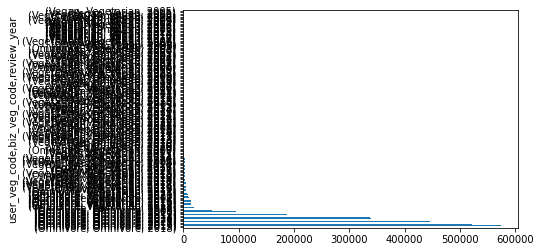

In [ ]:
trends_df[['user_veg_code','biz_veg_code', 'review_year']].value_counts().plot(kind='barh')

In [ ]:
trends_df.head()

,user_id,business_id,review_year,stars,is_vegan_restaurant,is_vegetarian_restaurant,biz_veg_code,is_omnivore_restaurant,user_vegan,user_vegetarian,user_omnivore,user_veg_code
0,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,2018,3,0,0,Omnivore,True,0.000000,0.000000,1.000000,Omnivore
1,Iaee7y6zdSB3B-kRCo4z1w,XQfwVwDr-v0ZS3_CbbE5Xw,2017,2,0,0,Omnivore,True,0.000000,0.000000,1.000000,Omnivore
2,ejFxLGqQcWNLdNByJlIhnQ,XQfwVwDr-v0ZS3_CbbE5Xw,2017,4,0,0,Omnivore,True,0.020619,0.061856,0.938144,Omnivore
3,f7xa0p_1V9lx53iIGN5Sug,XQfwVwDr-v0ZS3_CbbE5Xw,2017,3,0,0,Omnivore,True,0.018692,0.037383,0.962617,Omnivore
4,dCooFVCk8M1nVaQqcfTL3Q,XQfwVwDr-v0ZS3_CbbE5Xw,2017,2,0,0,Omnivore,True,0.000000,0.000000,1.000000,Omnivore


In [8]:
#count = trends_df[['user_veg_code','biz_veg_code', 'review_year']].value_counts()
count = df[['biz_veg_code', 'review_year']].value_counts()
print(count)

biz_veg_code  review_year
Omnivore      2018           579336
              2019           577746
              2017           523937
              2016           484884
              2015           447980
              2021           390882
              2020           340531
              2014           338962
              2013           248549
              2012           189074
              2011           155337
              2010            95064
              2009            51343
              2008            30639
Vegetarian    2018            23658
              2019            22553
              2017            22151
              2016            20801
Omnivore      2022            19848
Vegetarian    2015            18981
              2014            14506
              2021            12614
              2020            12503
              2013            10467
Omnivore      2007            10136
Vegetarian    2012             8740
Vegan         2019             7969
  

In [32]:
grouped_df2 = df.groupby(by=["review_year","user_veg_code"], as_index=False).agg(
    {"stars_x": "mean"}
)

In [33]:
fig3 = px.line(data_frame = grouped_df2, x='review_year', y='stars_x', labels={
                     'review_year': 'Review Year',
                     'stars_x': 'Average Star Rating',
                     'user_veg_code': 'Reviewer Type'
                     }, 
               color = 'user_veg_code', color_discrete_sequence=['red','green','blue'], title = 'Star Rating by Food Type over Time')
fig3.update_layout(
    title={
        'text': "Star Rating by Reviewer Type over Time",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig3.update_xaxes(dtick = 1)
fig3.update_layout(yaxis=dict(range=[0,5]))
fig3.show()
#This is graphing the restaurant reviews by year

In [16]:
#Graphing how each type of restaurant gets evaluated by people with different diets

fig4 = px.line(data_frame = df.groupby(by=["review_year","user_veg_code", "biz_veg_code"], as_index=False).agg({"stars_x": "mean"}), 
    x='review_year', y='stars_x', line_group = 'user_veg_code', color = 'user_veg_code', color_discrete_sequence=['red','green','blue'], facet_col = 'biz_veg_code', title = "Star Ratings by Food Type and User Type", 
    labels={
                     'review_year': 'Review Year',
                     'stars_x': 'Average Star Rating',
                     'biz_veg_code': 'Restaurant Type',
                    'user_veg_code': 'Reviewer Type'
                     })
fig4.update_xaxes(dtick = 1)
fig4.update_yaxes(range = [0,5])

fig4.show()

In [18]:
summary_ratings = df.groupby('user_veg_code')['stars_x'].agg([np.mean, np.std, np.var])
print(summary_ratings)

                   mean       std       var
user_veg_code                              
Omnivore       3.785441  1.410012  1.988134
Vegan          4.063404  1.325204  1.756167
Vegetarian     3.919331  1.374850  1.890211


In [19]:
stats.f_oneway(df['stars_x'][df['user_veg_code'] == 'Omnivore'],
               df['stars_x'][df['user_veg_code'] == 'Vegetarian'],
               df['stars_x'][df['user_veg_code'] == 'Vegan'])


F_onewayResult(statistic=3817.287042080279, pvalue=0.0)

In [23]:
sp.posthoc_tukey(df, val_col='stars_x', group_col='user_veg_code')

,Omnivore,Vegetarian,Vegan
Omnivore,1.000,0.001,0.001
Vegetarian,0.001,1.000,0.001
Vegan,0.001,0.001,1.000


[Text(0, 0.5, 'Count'),
 Text(0.5, 0, 'User Type'),
 Text(0.5, 1.0, 'Yearly Review Count by User Type')]

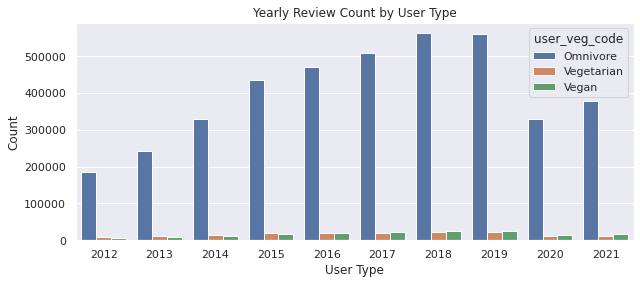

In [45]:
#Graphing how each type of restaurant gets evaluated by people with different diets

# fig3 = px.histogram(data_frame = df.groupby(by=["review_year","user_veg_code", "biz_veg_code"], as_index=False).agg({"stars_x": "mean"}), 
#     x='review_year', color = 'user_veg_code', color_discrete_sequence=['red','green','blue'], facet_col = 'biz_veg_code', title = "Review Frequency by Food Type and User Type")
# fig3.update_xaxes(dtick = 1)
 
# fig3.show()
sns.set(rc={"figure.figsize":(10, 4)})
ax = sns.countplot(data=df, x="review_year", hue="user_veg_code")
ax.set(xlabel='User Type', ylabel = 'Count', title = 'Yearly Review Count by User Type')



In [11]:
df.review_year.value_counts()

2018    610694
2019    608268
2017    552447
2016    511217
2015    471905
2021    409047
2020    358311
2014    356834
2013    261253
2012    199230
2011    163639
2010    100186
2009     54093
2008     32419
2022     20699
2007     10779
2006      2830
2005       620
Name: review_year, dtype: int64

In [9]:
#filter out review_year > 2020
#Change line plot to scatter

fig4 = px.scatter(data_frame = df, x='review_year', y='stars_x', color = 'user_veg_code', color_discrete_sequence=['red','green','blue'], facet_col = 'biz_veg_code', title = "Star Ratings by Food Type and User Type")
fig4.update_xaxes(dtick = 1)

fig4.show()

In [42]:
fig5 = px.line(data_frame = df.groupby(by=["review_year","user_veg_code", "biz_veg_code"], as_index=False).agg({"stars_x": "count"}), 
    x='review_year', y='stars_x', line_group = 'user_veg_code', color = 'user_veg_code', color_discrete_sequence=['red','green','blue'], facet_col = 'biz_veg_code', title = "Star Ratings by Food Type and User Type")
fig5.update_xaxes(dtick = 1)

fig5.show()

In [ ]:
#Investigate number of reviews by year and Business Type

grouped_df3 = trends_df.groupby(by=["review_year","user_veg_code", "biz_veg_code"], as_index=False).agg({'stars':'size'}
)

fig4 = px.line(data_frame = grouped_df3, x='review_year', y='stars', line_group = 'user_veg_code', color = 'user_veg_code', color_discrete_sequence=['red','blue','green'], facet_col = 'biz_veg_code', title = "Number of Reviews by Business Type and User Type")
fig4.update_xaxes(dtick = 1)

fig4.show()

In [ ]:
#Average NLP sentiment score over time/by year


In [ ]:
#Wordcloud on positive and negative reviews

from wordcloud import WordCloud


In [ ]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#Ignore this
#Lightweight NLP 


# Import libraries
from transformers import pipeline

# Create an NLP pipeline that runs sentiment analysis
classifier = pipeline("sentiment-analysis")

# Classify some text (this may download some data and models the first time you run it)
#sentiment_1 = classifier("I hate machine learning! It's the absolute worst.")
#sentiment_2 = classifier("Machine learning is the absolute bees knees I love it so much!")

# Print sentiment output
#print(sentiment_1, sentiment_2)

No model was supplied, defaulted to distilbert-base-uncased-finetuned-sst-2-english and revision af0f99b (https://huggingface.co/distilbert-base-uncased-finetuned-sst-2-english).
Using a pipeline without specifying a model name and revision in production is not recommended.


In [ ]:
restaurants['sentiment'] = [classifier("".join(text.split()[:512])) for text in restaurants['text']]

RuntimeError: ignored

In [ ]:
max(restaurants['text'].agg(len))

5052

In [ ]:
#Print text that fails running through sentiment analysis:

for text in restaurants['text']:
    try:
        classifier("".join(text.split()[:512]))
    except:
        print(text) 
        raise ValueError

I think I may have been let down by this place because of all the rave reviews. But the fact is, I've eaten here twice and neither time was spectacular. 

My expectations of a breakfast place are cheap prices, good food (because eggs are hard to mess up), fast turnover and service. This place has prices on the high end of breakfast place, on weekends they are very crowded and it will take some time to be seated and the food is alright. 

The last time I went, I was with my husband and we went in the door to a huge crowd. There was no wait to be seated sign, but we guessed correctly and waited. Problem is that you pay and wait in the same place, which meant people were coming and going in a very small area. It was chaos for awhile. Finally we were seated outside at a picnic table and told that other people may be seated with us at the table, because they lacked space. 

The waitress took some time to arrive and by then we were ready to give our order. I ordered eggs and bacon and toast.

NameError: ignored

In [ ]:
large_txt = """ 
I think I may have been let down by this place because of all the rave reviews. But the fact is, I've eaten here twice and neither time was spectacular. 

My expectations of a breakfast place are cheap prices, good food (because eggs are hard to mess up), fast turnover and service. This place has prices on the high end of breakfast place, on weekends they are very crowded and it will take some time to be seated and the food is alright. 

The last time I went, I was with my husband and we went in the door to a huge crowd. There was no wait to be seated sign, but we guessed correctly and waited. Problem is that you pay and wait in the same place, which meant people were coming and going in a very small area. It was chaos for awhile. Finally we were seated outside at a picnic table and told that other people may be seated with us at the table, because they lacked space. 

The waitress took some time to arrive and by then we were ready to give our order. I ordered eggs and bacon and toast. We also each ordered fruit smoothies. I asked for mine without banana. The waitress came back a few minutes later and said with a straight face, "The guys back there put like three bananas in your smoothie!" 

It took me a minute to realize she was joking....heh....

We played several rounds of Scrabble on an iphone because the food was taking quite awhile and it finally came out. Our drinks were no where to be seen. We had to ask twice for them. By then we were almost done the food!

The food was alright, but I usually go to places like Egg Smart and for the cost, they give you way more food, for a better price and honestly, I think it tastes way better. These famous "Boom frites" are just thick, cut potatoes and they give you one slice of toast! 

Anyway, if you're in the area and really want some breakfast, it's not terrible, but I think you can do way better! 

Oh, and I disagree that it's a good place for a group. Unless you want to wait forever...or make a group by joining another couple at their picnic table!

"""

In [ ]:
#Note that the classifier evaluates the text above as positive!  This is concerning for quality issues.

classifier(large_txt)

[{'label': 'POSITIVE', 'score': 0.8209519982337952}]

In [ ]:
results = []
for text in restaurants['text']:
    try:
        results.append(classifier("".join(text.split()[:512])))
    except Exception as e:
        results.append(None)
        print(e) 

Streaming output truncated to the last 5000 lines.
The size of tensor a (829) must match the size of tensor b (512) at non-singleton dimension 1
The size of tensor a (544) must match the size of tensor b (512) at non-singleton dimension 1
The size of tensor a (668) must match the size of tensor b (512) at non-singleton dimension 1
The size of tensor a (652) must match the size of tensor b (512) at non-singleton dimension 1
The size of tensor a (812) must match the size of tensor b (512) at non-singleton dimension 1
The size of tensor a (603) must match the size of tensor b (512) at non-singleton dimension 1
The size of tensor a (522) must match the size of tensor b (512) at non-singleton dimension 1
The size of tensor a (552) must match the size of tensor b (512) at non-singleton dimension 1
The size of tensor a (519) must match the size of tensor b (512) at non-singleton dimension 1
The size of tensor a (636) must match the size of tensor b (512) at non-singleton dimension 1
The size 

In [ ]:
results = []
for text in restaurants['text']:
    try:
        results.append(classifier(text[:512]))
    except Exception as e:
        results.append(None)
        print(e) 

KeyboardInterrupt: ignored

In [ ]:
classifier(large_txt[:512])

[{'label': 'POSITIVE', 'score': 0.9978985786437988}]

In [ ]:
restaurants['sentiment'] = results

In [ ]:
#Score of classifier is confidence 
#Can compare counts of 'Positive' and 'Negative' - but this may be unreliable.
#Note that the example of "large_txt" gives the wrong sentiment at high confidence

In [ ]:
%matplotlib inline

In [ ]:
#This way to refer to vegan restaurants, though be careful about eating up memory:
#vegan_restaurants = restaurants[restaurants['biz_veg_code'] == 'vegan']['text']
#vegetarian_restaurants = restaurants[restaurants['biz_veg_code'] == 'vegetarian']
#omnivore_restaurants = restaurants[restaurants['biz_veg_code'] == 'omnivore']

In [ ]:
import re

# Convert all the string to lower cases
restaurants['text'] = restaurants['text'].str.lower()

# \s+ means all empty space (\n, \r, \t)
restaurants['text'] = restaurants['text'].apply(lambda x: re.sub('\s+', ' ', x))

#remove punctuation
restaurants['text'] = restaurants['text'].apply(lambda x: re.sub('[^\w\s]', '', x))

import nltk

# Uncomment the following line the first time you run the code
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')


from nltk.corpus import stopwords
stop = stopwords.words('english')
#print(stop)

#removing stopwords
restaurants['text'] = restaurants['text'].apply(lambda text: " ".join(word for word in text.split() if word not in stop))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
wc = WordCloud(background_color="white", max_words=2000, width=800, height=400)
# generate vegan word cloud
wc.generate(' '.join(restaurants[restaurants['biz_veg_code'] == 'Vegan']['text']))

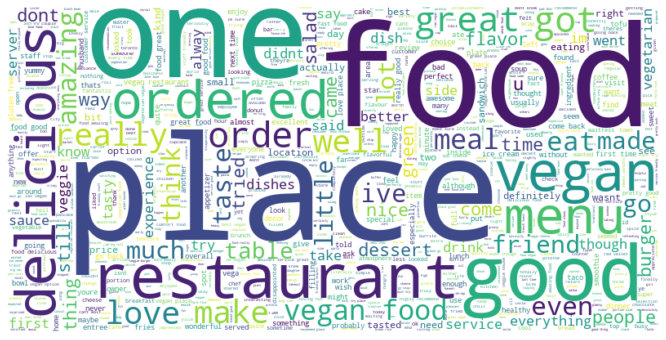

In [ ]:
# show
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

In [ ]:
wc2 = WordCloud(background_color="white", max_words=2000, width=800, height=400)
# generate vegetarian word cloud
wc2.generate(' '.join(restaurants[restaurants['biz_veg_code'] == 'Vegetarian']['text']))

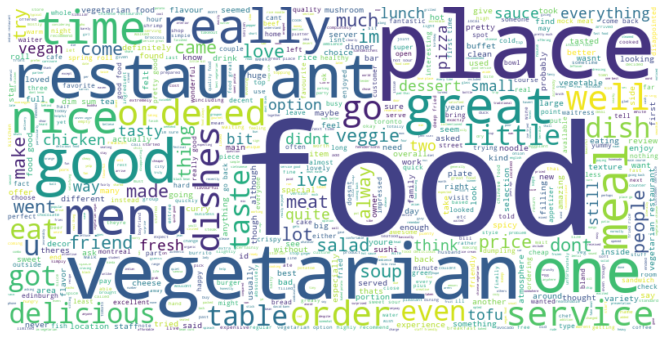

In [ ]:
# show
plt.figure(figsize=(12, 6))
plt.imshow(wc2, interpolation='bilinear')
plt.axis("off")
plt.show()

In [ ]:
#This file is too big to run on the merged data.  

wc3 = WordCloud(background_color="white", max_words=2000, width=800, height=400)
# generate vegan word cloud
wc3.generate(' '.join(restaurants[restaurants['biz_veg_code'] == 'Omnivore']['text']))
# show
plt.figure(figsize=(12, 6))
plt.imshow(wc3, interpolation='bilinear')
plt.axis("off")
plt.show()

In [ ]:
#Failed attempt to run wordcloud on 1/3 of the data:

#DO NOT RUN
reviews_df1 = reviews_df1.loc[reviews_df1['text'].str.contains("food", case=False, flags=0, na=None, regex = False)]
reviews_df1['vegetarian_review'] = reviews_df1['text'].str.contains("vegetarian", case=False, flags=0, na=None, regex = False)
reviews_df1['vegan_review'] = reviews_df1['text'].str.contains("vegan", case=False, flags=0, na=None, regex = False)

reviews_df1['review_veg_code'] = reviews_df1.apply(lambda x: veg_code(x['vegetarian_review'],x['vegan_review']), axis = 1)
reviews_df1['omnivore_review'] = reviews_df1.apply(lambda x: is_omnivore(x['vegetarian_review'],x['vegan_review']), axis = 1)

user_veg_code = reviews_df1.groupby(['user_id'])[['vegan_review', 'vegetarian_review','omnivore_review']].mean()
biz_veg_code = reviews_df1.groupby(['business_id'])[['vegan_review', 'vegetarian_review','omnivore_review']].mean()

user_veg_code.columns = ['user_vegan', 'user_vegetarian', 'user_omnivore']
biz_veg_code.columns = ['biz_vegan', 'biz_vegetarian', 'biz_omnivore']

reviews_df1 = pd.merge(reviews_df1, user_veg_code, how = 'left', on = 'user_id')
reviews_df1 = pd.merge(reviews_df1, biz_veg_code, how = 'left', on = 'business_id')



reviews_df1['user_veg_code'] = reviews_df1.apply(lambda x: veg_quant(x['user_vegetarian'],x['user_vegan']), axis = 1)
reviews_df1['biz_veg_code'] = reviews_df1.apply(lambda x: veg_quant(x['biz_vegetarian'],x['biz_vegan']), axis = 1)

reviews_df1.head()

from wordcloud import WordCloud

wc4 = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc4.generate(' '.join(reviews_df1[reviews_df1['biz_veg_code'] == 'Omnivore']['text']))

In [ ]:
#TRYNG SENTIMENT ANALYSIS WITH RANDOMLY SAMPLED SUBSET OF DATA

df['date'] = pd.to_datetime(df['date'])

df['review_year'] = df['date'].dt.year
df['review_month'] = df['date'].dt.month
df['review_day'] = df['date'].dt.day

#merged_reviews_123.loc[merged_reviews_123['text'].str.contains("food", case=False, flags=0, na=None, regex = False)]
df['vegetarian_review'] = df['text'].str.contains("vegetarian", case=False, flags=0, na=None, regex = False)
df['vegan_review'] = df['text'].str.contains("vegan", case=False, flags=0, na=None, regex = False)

df['review_veg_code'] = df.apply(lambda x: veg_code(x['vegetarian_review'],x['vegan_review']), axis = 1)
df['omnivore_review'] = df.apply(lambda x: is_omnivore(x['vegetarian_review'],x['vegan_review']), axis = 1)

user_veg_code = df.groupby(['user_id'])[['vegan_review', 'vegetarian_review','omnivore_review']].mean()
biz_veg_code = df.groupby(['business_id'])[['vegan_review', 'vegetarian_review','omnivore_review']].mean()

user_veg_code.columns = ['user_vegan', 'user_vegetarian', 'user_omnivore']
biz_veg_code.columns = ['biz_vegan', 'biz_vegetarian', 'biz_omnivore']

df = pd.merge(df, user_veg_code, how = 'left', on = 'user_id')
df = pd.merge(df, biz_veg_code, how = 'left', on = 'business_id')

df['user_veg_code'] = df.apply(lambda x: veg_quant(x['user_vegetarian'],x['user_vegan']), axis = 1)
df['biz_veg_code'] = df.apply(lambda x: veg_quant(x['biz_vegetarian'],x['biz_vegan']), axis = 1)

In [ ]:
df.head()

,review_id,user_id,business_id,stars,date,text,useful,funny,cool,review_year,...,review_veg_code,omnivore_review,user_vegan,user_vegetarian,user_omnivore,biz_vegan,biz_vegetarian,biz_omnivore,user_veg_code,biz_veg_code
0,SlXVmKGv10icLuSrqeuqgQ,u0LXt3Uea_GidxRW1xcsfg,qR62k9TVEVwRuQH6-4avHA,4,2011-09-28,cozy heart st catherine street comfy bed wirel...,1,0,0,2011,...,Omnivore,True,0.0,0.0,1.0,0.0,0.0,1.0,Omnivore,Omnivore
1,KUpwkKb7sue22o__HLilow,u0LXt3Uea_GidxRW1xcsfg,ZilzayEdyk70SoI-wruJbg,4,2017-01-04,stop girlfriend whenever im back always order ...,0,0,0,2017,...,Omnivore,True,0.0,0.0,1.0,0.0,0.0,1.0,Omnivore,Omnivore
2,udzzB55YAxWEfVmkcZGYSA,nOTl4aPC4tKHK35T3bNauQ,VTs4f6LnUMHD4ysOezHSUQ,4,2012-07-08,sometimes feels good badfor dying try actual p...,1,0,0,2012,...,Omnivore,True,0.0,0.0,1.0,0.0,0.0,1.0,Omnivore,Omnivore
3,cxZaVX0Jf3SWJqUDWnca5Q,nOTl4aPC4tKHK35T3bNauQ,EjZYT46Y2qHSoChynd0q-A,4,2012-11-11,small gallery bit hard get present constructio...,0,0,0,2012,...,Omnivore,True,0.0,0.0,1.0,0.0,0.0,1.0,Omnivore,Omnivore
4,8yfmu2iAagShVXJUGVTELw,tL2pS5UOmN6aAOi3Z-qFGg,6zry3kyGHiplbQ4rdqxbaQ,4,2013-07-17,challenging hike one prominent peaks red rock ...,0,0,0,2013,...,Omnivore,True,0.0,0.0,1.0,0.0,0.0,1.0,Omnivore,Omnivore


In [ ]:
import re

# Convert all the string to lower cases
df['text'] = df['text'].str.lower()

# \s+ means all empty space (\n, \r, \t)
df['text'] = df['text'].apply(lambda x: re.sub('\s+', ' ', x))

#remove punctuation
df['text'] = df['text'].apply(lambda x: re.sub('[^\w\s]', '', x))

import nltk

# Uncomment the following line the first time you run the code
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')


from nltk.corpus import stopwords
stop = stopwords.words('english')
#print(stop)

#removing stopwords
df['text'] = df['text'].apply(lambda text: " ".join(word for word in text.split() if word not in stop))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
from wordcloud import WordCloud

wc4 = WordCloud(background_color="white", max_words=2000, width=800, height=400)
wc4.generate(' '.join(df[df['biz_veg_code'] == 'Omnivore']['text']))

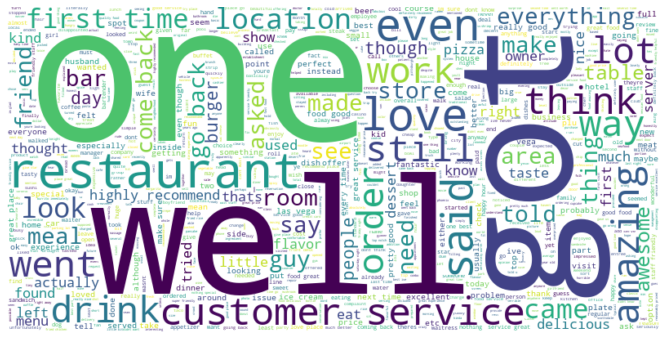

In [ ]:
# show
plt.figure(figsize=(12, 6))
plt.imshow(wc4, interpolation='bilinear')
plt.axis("off")
plt.show()

In [ ]:
results = []
for text in df['text']:
  results.append(classifier(text))

RuntimeError: ignored

In [ ]:
results[0:5]

[[{'label': 'POSITIVE', 'score': 0.9996058344841003}],
 [{'label': 'POSITIVE', 'score': 0.9928414821624756}],
 [{'label': 'POSITIVE', 'score': 0.7890985012054443}],
 [{'label': 'POSITIVE', 'score': 0.9987228512763977}],
 [{'label': 'POSITIVE', 'score': 0.9997100234031677}]]

In [ ]:
len(df['text'][3])

1155

In [ ]:
classifier(df['text'][3])

[{'label': 'NEGATIVE', 'score': 0.9987712502479553}]

In [ ]:
len(df['text'][2].split(' '))

709

In [ ]:
#String split the text column
#If length > 512, index it from 0 to 511, else return original list
#convert list to string
#run classifier on reduced text column (it only works on strings, not lists)